# Train YOLOv8 Object Detection on Custom Dataset

In [ ]:
!pip install -q git+https://github.com/THU-MIG/yolov10.git
!pip install -q roboflow

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 43.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.2/76.2 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 6.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 5.3 MB/s eta 0:00:00


## Download pre-trained weights for all the models

In [ ]:
import os
import urllib.request

# create a directory for weights in the current working directory
weights_dir = os.path.join(os.getcwd(), 'weights')
os.makedirs(weights_dir, exist_ok=True)

# URLs of the weight files
urls = [
    'https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10n.pt',
    'https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10s.pt',
    'https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10m.pt',
    'https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10b.pt',
    'https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10x.pt',
    'https://github.com/THU-MIG/yolov10/releases/download/v1.1/yolov10l.pt'
]

# download files
for url in urls:
    file_name = os.path.join(weights_dir, os.path.basename(url))
    urllib.request.urlretrieve(url, file_name)
    print(f'Downloaded {file_name}')


Downloaded /content/weights/yolov10n.pt
Downloaded /content/weights/yolov10s.pt
Downloaded /content/weights/yolov10m.pt
Downloaded /content/weights/yolov10b.pt
Downloaded /content/weights/yolov10x.pt
Downloaded /content/weights/yolov10l.pt


In [ ]:
# !pip install roboflow

# from roboflow import Roboflow
# rf = Roboflow(api_key="x25vshzXveTa9Kan9exS")
# project = rf.workspace("jonac22").project("persons-and-cars")
# version = project.version(3)
# dataset = version.download("yolov8")


loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.1.34, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to Persons-and-cars-3 in yolov8:: 100%|██████████| 5884/5884 [00:01<00:00, 3572.52it/s]


In [21]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="x25vshzXveTa9Kan9exS")
project = rf.workspace("quidsml").project("person-car")
version = project.version(2)
dataset = version.download("yolov8")


loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics==8.0.196 is required but found version=8.1.34, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to person+car-2 in yolov8:: 100%|██████████| 755/755 [00:00<00:00, 6404.11it/s]


## Custom Training

In [4]:
!yolo task=detect mode=train epochs=100 batch=16 \
model='/content/weights/yolov10m.pt' \
data='/content/Persons-and-cars-3/data.yaml'

New https://pypi.org/project/ultralytics/8.2.50 available 😃 Update with 'pip install -U ultralytics'
Ultralytics YOLOv8.1.34 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/weights/yolov10m.pt, data=/content/Persons-and-cars-3/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, val_period=1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_

## Confusion Matrix

In [5]:
from IPython.display import Image
from ultralytics import YOLOv10

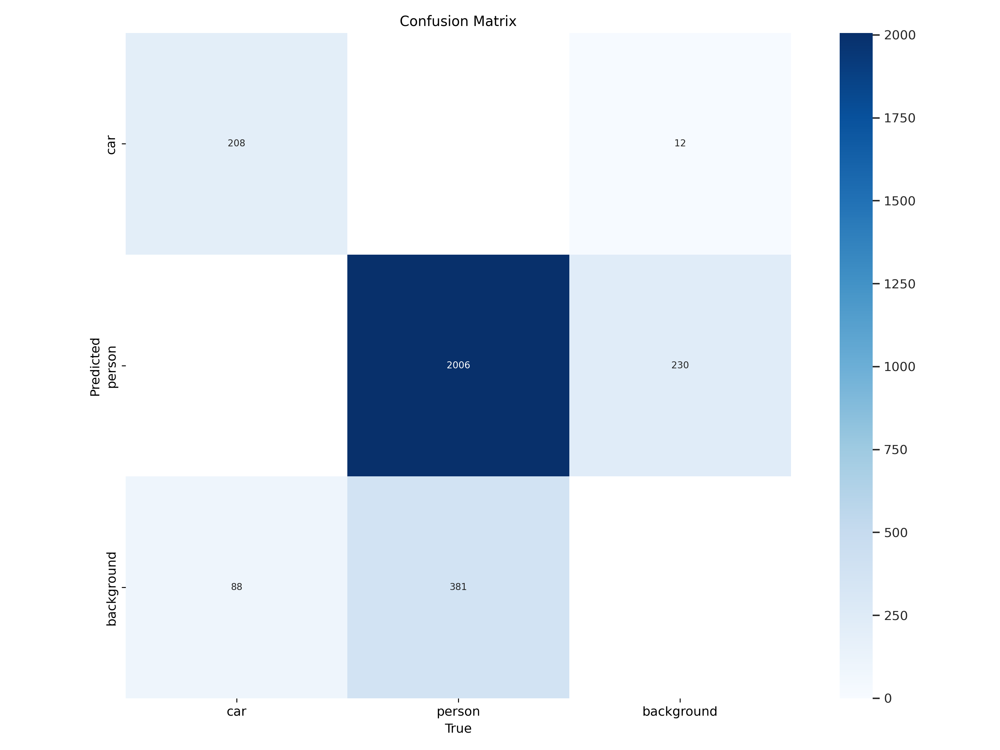

In [6]:
Image(filename='/content/runs/detect/train/confusion_matrix.png', width=600)

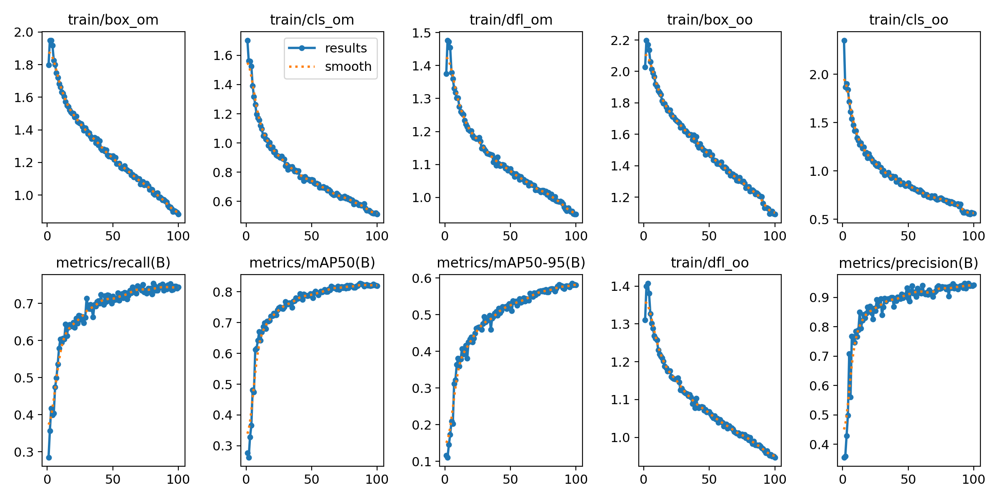

In [8]:
Image(filename='/content/runs/detect/train/results.png', width=600)

## Testing the trained model

In [10]:
model_path = '/content/runs/detect/train/weights/best.pt'
model = YOLOv10(model_path)
results = model(source='/content/Persons-and-cars-3/test/images', conf=0.25, save=True)


image 1/289 /content/Persons-and-cars-3/test/images/-019AB9D4-15D1-4469-8108-7F31E8506542-png_jpg.rf.0c7355eae98be7ac53d8100789f3147a.jpg: 640x640 2 cars, 34.1ms
image 2/289 /content/Persons-and-cars-3/test/images/-02F6E0DC-CC38-4C5F-AEE6-8791AF00FC87-png_jpg.rf.a3748401ab1060defd4b907a0f78f1cd.jpg: 640x640 1 car, 34.1ms
image 3/289 /content/Persons-and-cars-3/test/images/-04D8EC39-2AE0-4E16-9210-CB13705ACC14-png_jpg.rf.f7454e2d05d993a0ba50273c01f9d465.jpg: 640x640 1 car, 34.1ms
image 4/289 /content/Persons-and-cars-3/test/images/-0585CFA0-7CD6-45D3-B7EB-1A109425F90D-png_jpg.rf.0b3ae107fa9706d8ef087264c7de5018.jpg: 640x640 1 car, 34.0ms
image 5/289 /content/Persons-and-cars-3/test/images/-05A70844-9653-4F87-9807-1ED0709FED44-png_jpg.rf.09461ff5838f2ff3b08e1d57b6f49785.jpg: 640x640 1 car, 34.0ms
image 6/289 /content/Persons-and-cars-3/test/images/-0945FFF1-B95A-49D9-AF38-521144CBA0A7-png_jpg.rf.a1d4a7e52ac0013db96bfa9855996fb1.jpg: 640x640 2 cars, 34.0ms
image 7/289 /content/Persons-an

## Testing on images

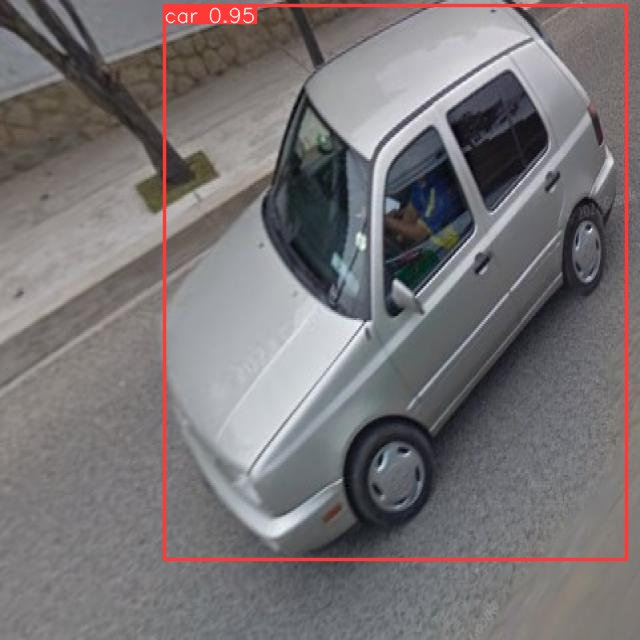

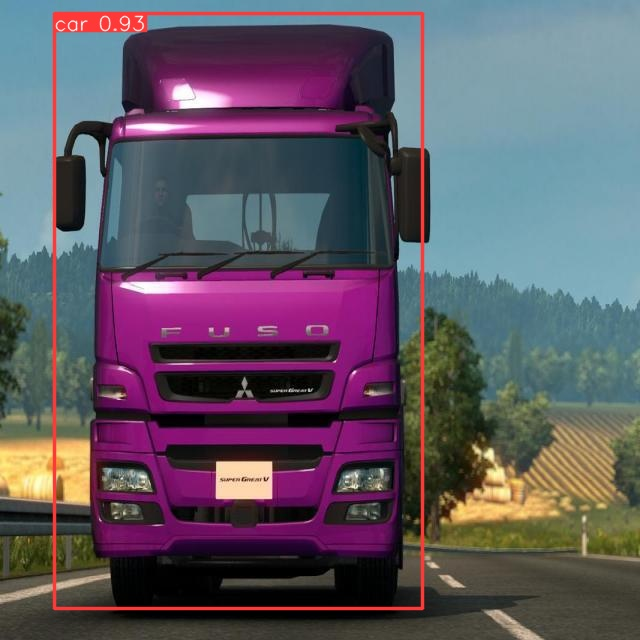

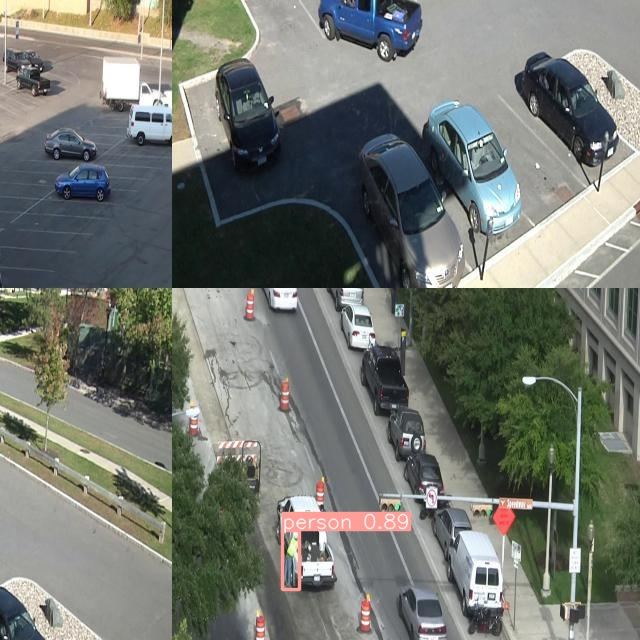

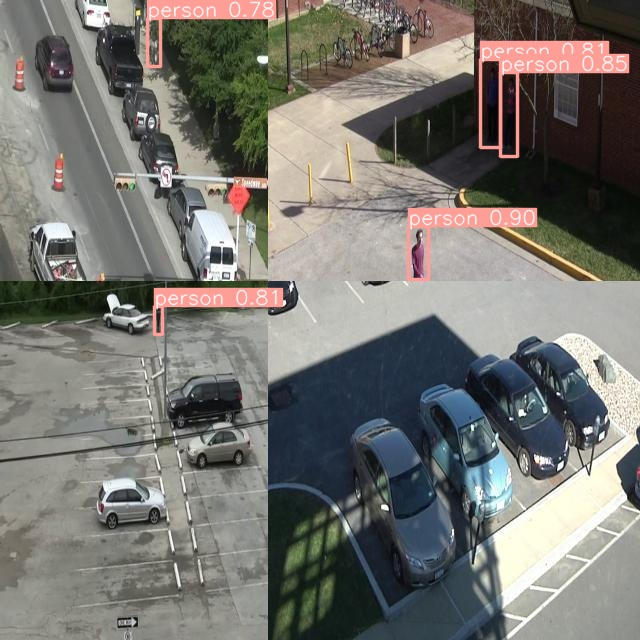

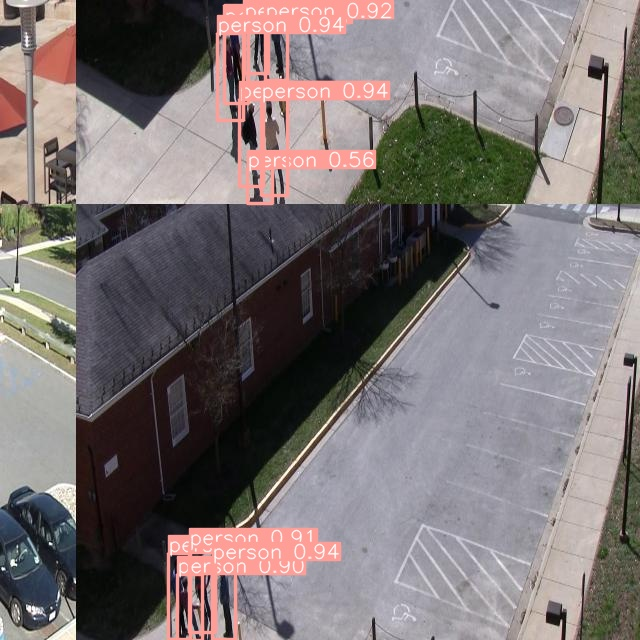

...

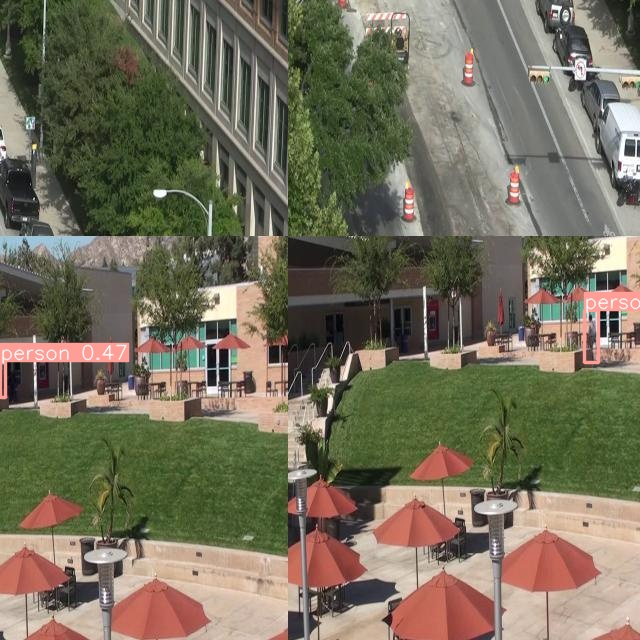

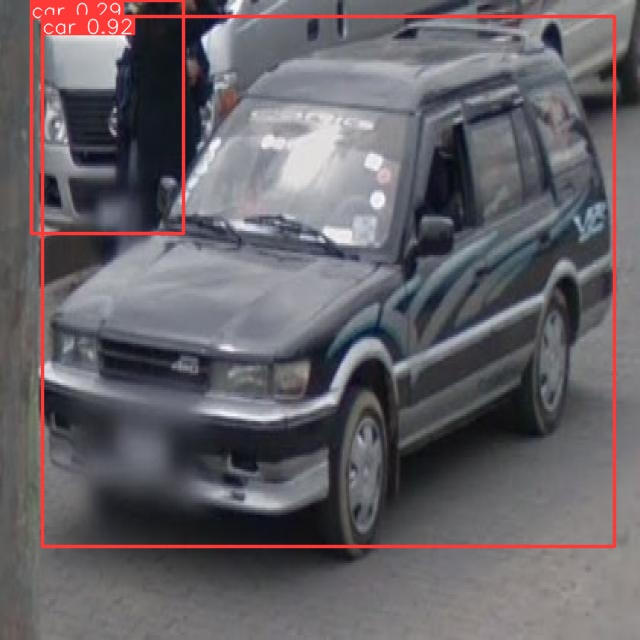

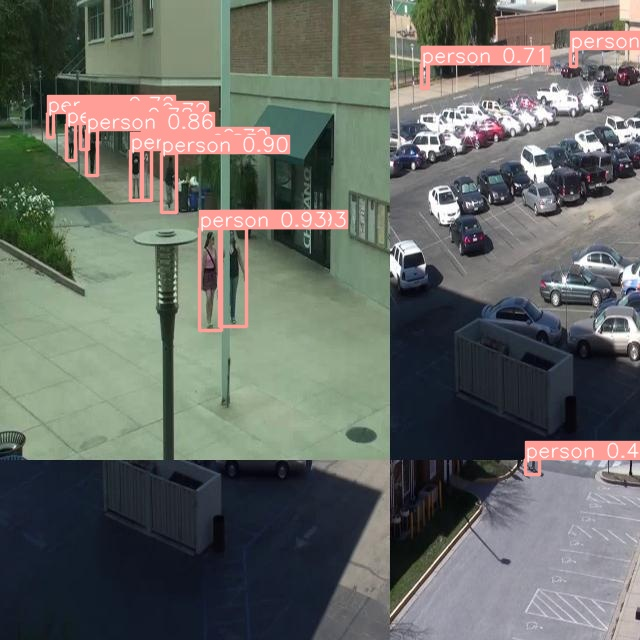

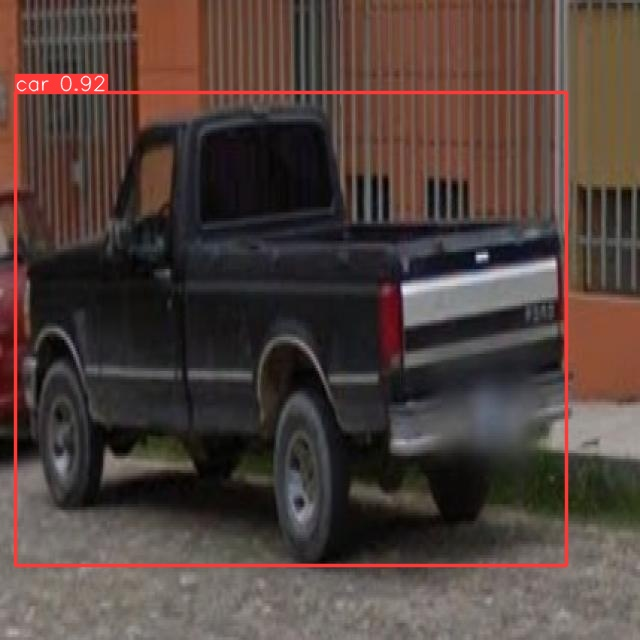

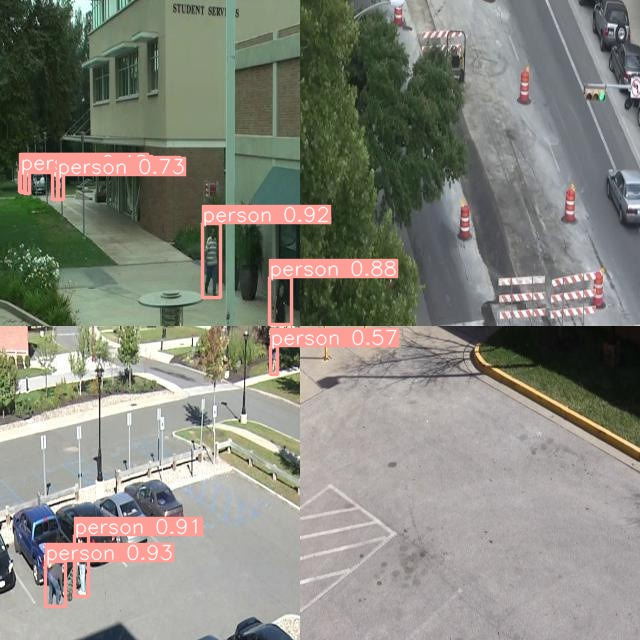

In [11]:
import glob
images = glob.glob('/content/runs/detect/predict/*.jpg')
for image in images:
  display(Image(filename=image, width=400))

## Testing on video

In [20]:
# results = model(source='/content/test_video3.mp4', conf=0.25, save=True)
results1 = model(source='/content/test_video4.mp4', conf=0.25, save=True)




WARNING ⚠️ inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/741) /content/test_video4.mp4: 384x640 1 car, 2 persons, 24.9ms
video 1/1 (frame 2/741) /content/test_video4.mp4: 384x640 2 persons, 44.9ms
video 1/1 (frame 3/741) /content/test_video4.mp4: 384x640 1 car, 3 persons, 36.1ms
video 1/1 (frame 4/741) /content/test_video4.mp4: 384x640 3 persons, 23.6ms
video 1/1 (frame 5/741) /content/test_video4.mp4: 384x640 2 persons, 23.6ms
video 1/1 (frame 6/741) /content/test_video4.mp4: 384x640 2 pe